# PythonによるscRNA-seq解析 その2:下流解析いろいろ

In [1]:
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn

import os
import numpy as np
import pandas as pd
import scanpy as sc
import scvi
import matplotlib.pyplot as plt
import seaborn as sns

sc.settings.verbosity = 3
sc.logging.print_header()
sc.settings.set_figure_params(dpi=100, facecolor='white')

scanpy==1.10.4 anndata==0.11.3 umap==0.5.7 numpy==2.1.3 scipy==1.15.1 pandas==2.2.2 scikit-learn==1.6.1 statsmodels==0.14.4 igraph==0.11.8 pynndescent==0.5.13


In [2]:
adata = sc.read_h5ad('./data/retinal_1.h5ad')

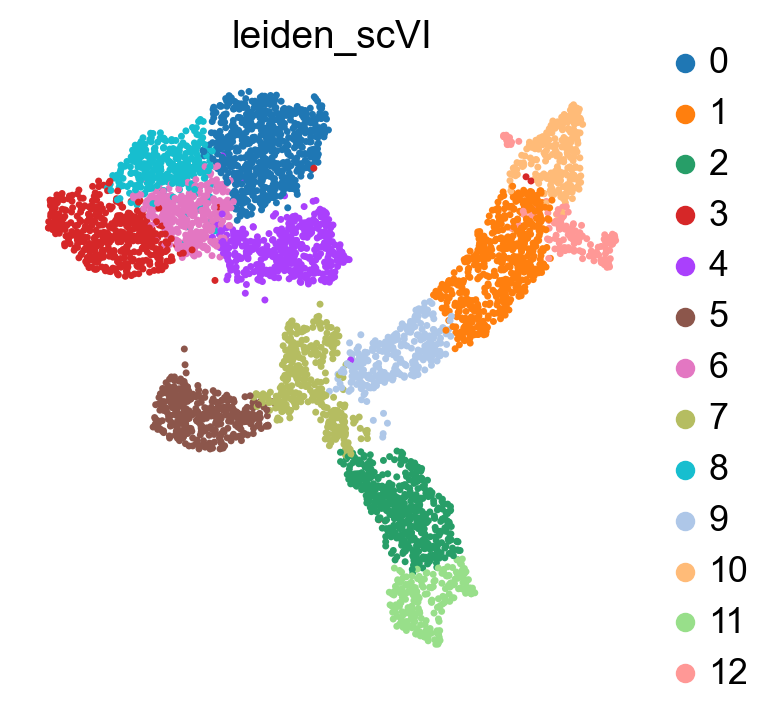

In [3]:
sc.pl.umap(adata, color=['leiden_scVI'], frameon=False)

In [4]:
adata

AnnData object with n_obs × n_vars = 4773 × 15001
    obs: 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden_r0.5', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'SOLO_prediction', '_scvi_raw_norm_scaling'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'SOLO_prediction_colors', '_scvi_manager_uuid', '_scvi_uuid', 'batch_colors', 'dendrogram_leiden_scVI', 'hvg', 'leiden_r0.5', 'leiden_r0.5_colors', 'leiden_scVI', 'leiden_scVI_colors', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_scVI', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'scvi_normalized'
    obsp: 'connectivities', 'distances'

## Cell typeのアノテーション

### マニュアルアノテーション

先行研究・文献、研究者の経験に基づいて細胞型ごとのマーカー遺伝子をリストアップし、それらの発現量からマニュアルで各クラスタのアノテーションをつけていく方法。

クラシカルな方法で、ある種恣意的な側面もあるが、判断根拠と責任の所在がはっきりしていて安心感がある。

以下の点に注意が必要。

1. クラスタレベルのアノテーションにならざるを得ないこと（とてもじゃないが1細胞ごとにマニュアルアノテーションできない）
2. かならずしもタンパク質マーカー＝遺伝子発現マーカーとは限らないこと（できるだけトランスクリプトーム解析の結果として定義されたマーカーを使う）
3. 「特定の研究・データセット」の結果が適用できるとは限らないこと（できるだけ複数の研究で報告されている遺伝子が望ましい）

In [5]:
# 文献： https://doi.org/10.1523/JNEUROSCI.0471-20.2020 
# および、https://doi.org/10.1167/iovs.64.11.2
# より抽出した。

my_markers = {
    'Amacrine cell':['Pax6', 'Slc32a1'],
    'Horizontal cell':['Lhx1'],
    'Bipolar cell':['Vsx2', 'Samsn1'],
    'Cone cell':['Opn1sw'],
    'RGC':['Slc17a6', 'Pou4f1'],
    'Muller cell':['Slc1a3', 'Lhx2']}

Amacrine cell


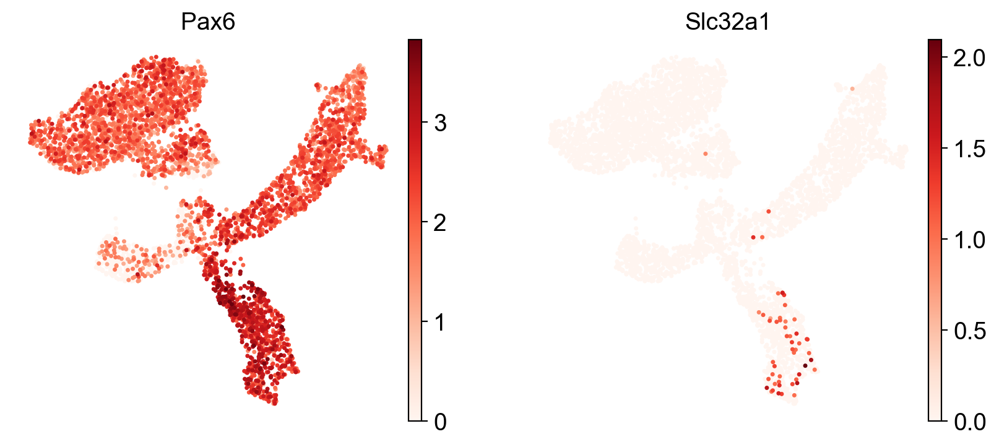

Horizontal cell


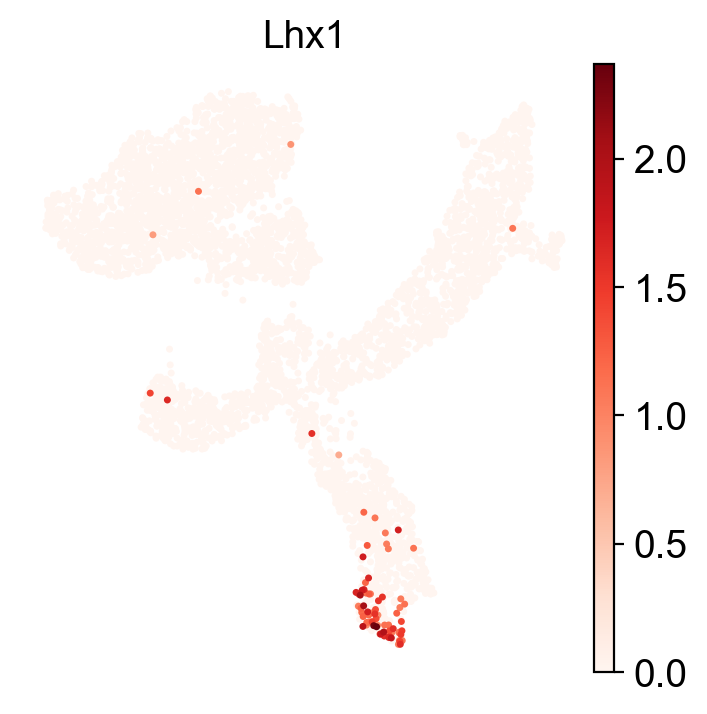

Bipolar cell


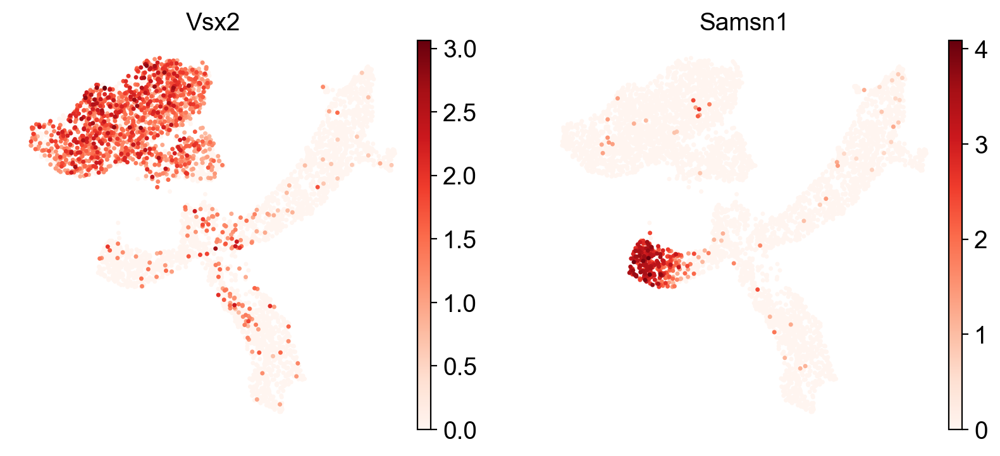

Cone cell


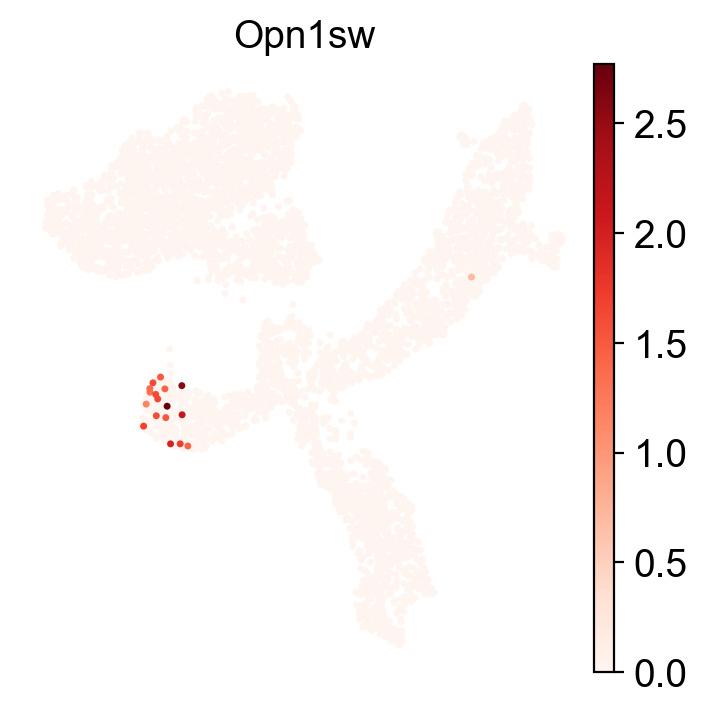

RGC


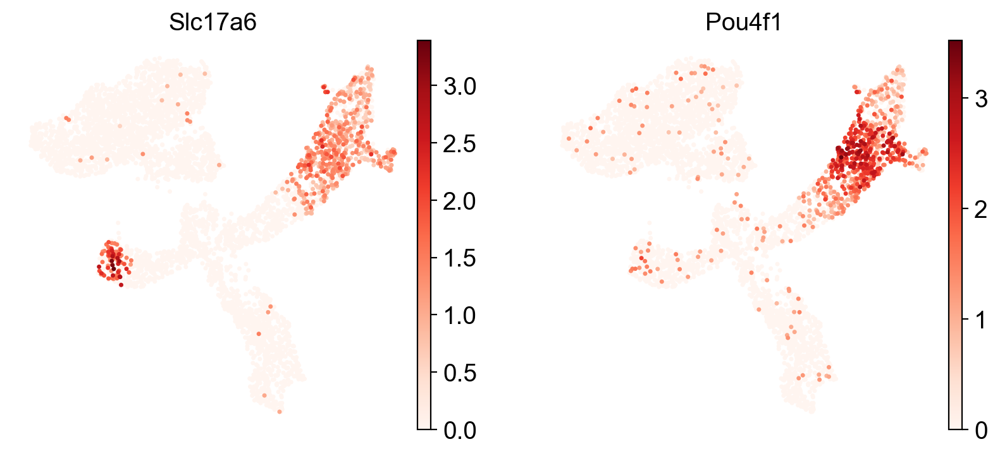

Muller cell


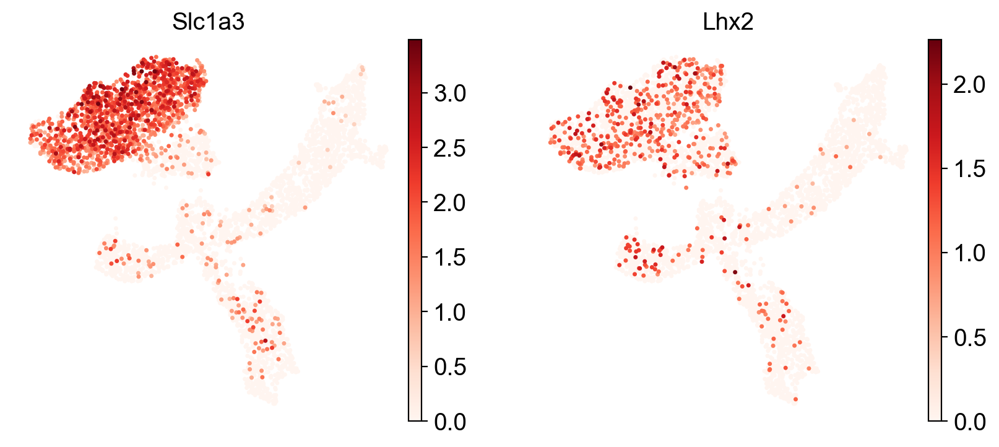

In [6]:
for celltype in my_markers.keys():
    print(celltype)
    sc.pl.umap(adata, color=my_markers[celltype], vmin=0, frameon=False, cmap='Reds')

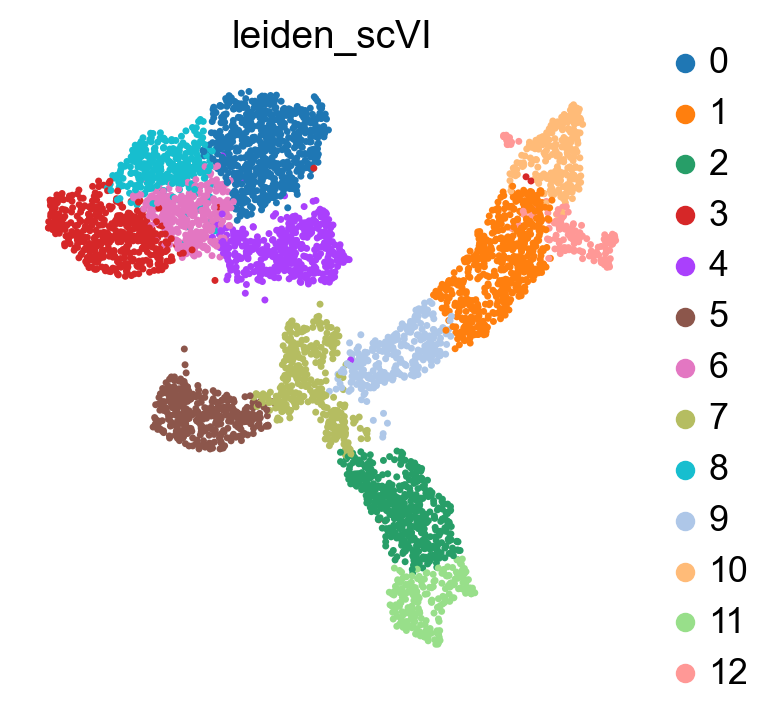

In [7]:
sc.pl.umap(adata, color=['leiden_scVI'], frameon=False)

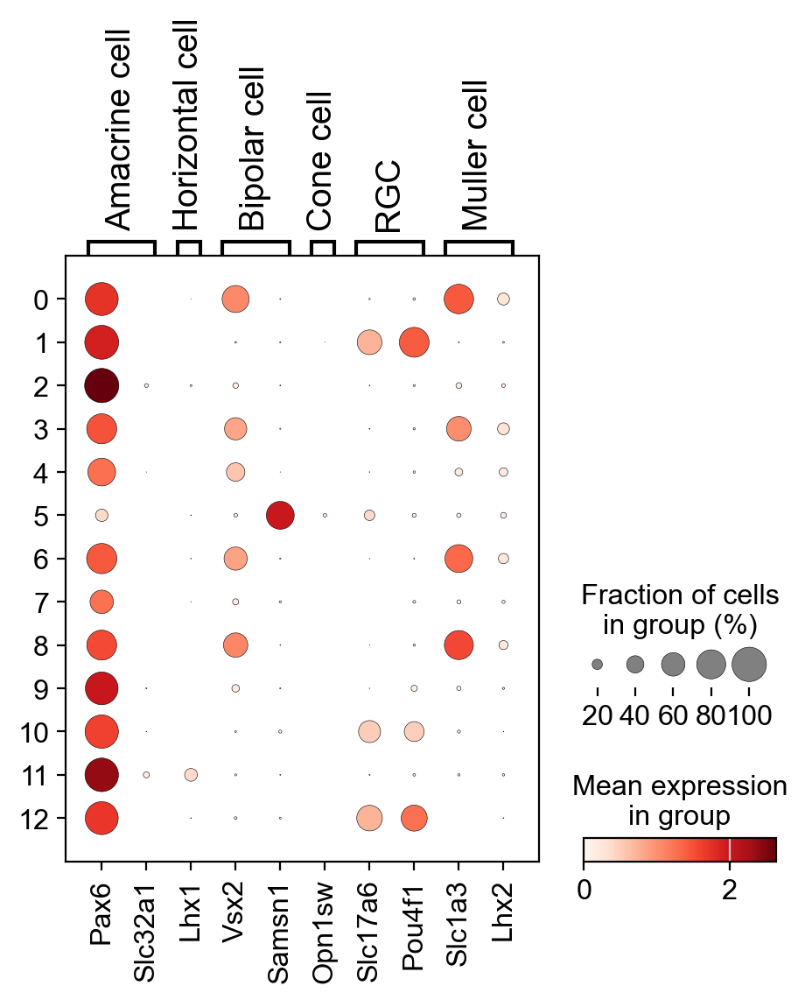

In [8]:
sc.pl.dotplot(adata,
              groupby='leiden_scVI',
              var_names=my_markers)

In [9]:
my_estimate = {
    '2':'Amacrine',
    '11':'Horizontal',
    '5':'Bipolar',
    '1':'RGC',
    '10':'RGC',
    '12':'RGC',
    '0':'Muller',
    '3':'Muller',
    '6':'Muller',
    '8':'Muller'}

In [10]:
adata.obs['Manual_annotation'] = adata.obs['leiden_scVI'].map(my_estimate)

In [11]:
adata.obs

,batch,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_counts,leiden_r0.5,_scvi_batch,_scvi_labels,leiden_scVI,SOLO_prediction,_scvi_raw_norm_scaling,Manual_annotation
AAACCTGAGATGTCGG-1-E2,E2,1776,1776,3776.0,112.0,2.966102,3776.0,1,0,0,3,singlet,2.648305,Muller
AAACCTGCAATCCAAC-1-E2,E2,1697,1697,3113.0,97.0,3.115965,3113.0,1,0,0,3,singlet,3.212335,Muller
AAACCTGTCCAATGGT-1-E2,E2,2102,2102,3925.0,91.0,2.318471,3925.0,8,0,0,2,singlet,2.547771,Amacrine
AAACGGGAGGCAATTA-1-E2,E2,3440,3440,10695.0,224.0,2.094437,10695.0,4,0,0,0,doublet,0.935016,Muller
AAACGGGCACGGCGTT-1-E2,E2,2019,2019,4322.0,228.0,5.275335,4322.0,4,0,0,0,singlet,2.313744,Muller
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAAGGGCTCTC-1-F2,F2,3009,3009,7465.0,143.0,1.915606,7465.0,9,1,0,1,singlet,1.339585,RGC
TTTGTCACATCGATGT-1-F2,F2,2507,2507,5026.0,135.0,2.686033,5026.0,3,1,0,2,singlet,1.989654,Amacrine
TTTGTCAGTAGAGGAA-1-F2,F2,2573,2573,6615.0,176.0,2.660620,6615.0,0,1,0,4,doublet,1.511716,NaN
TTTGTCAGTCATCCCT-1-F2,F2,2389,2389,4923.0,121.0,2.457851,4923.0,5,1,0,9,singlet,2.031282,NaN


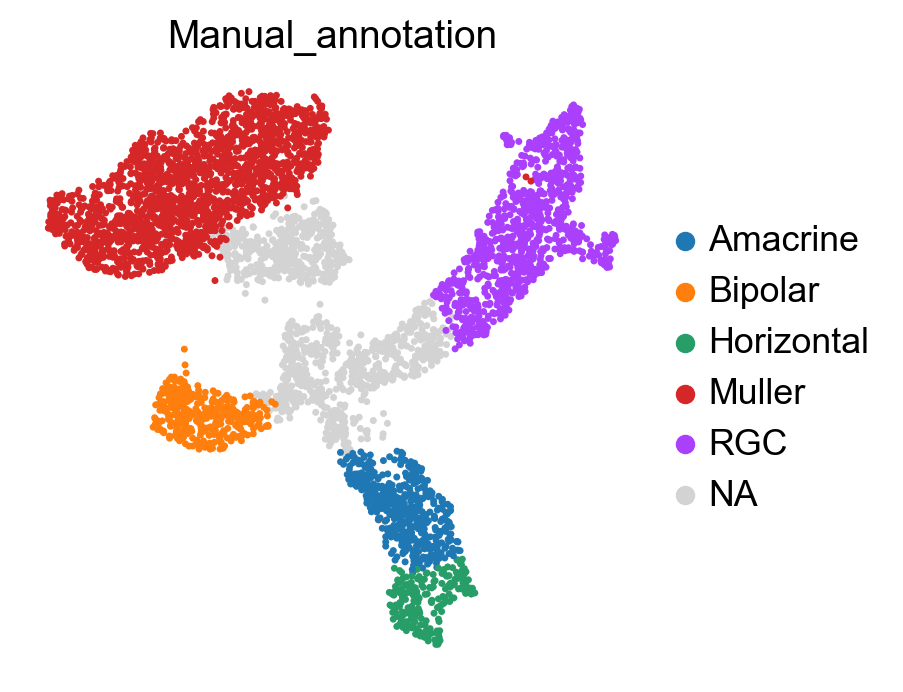

In [12]:
sc.pl.umap(adata, color=['Manual_annotation'], frameon=False)

## アトラスとの統合・ラベル転移

マーカー遺伝子を使ったアノテーションがあんまりうまくいってないっぽいので、今度は「リファレンスデータからのラベル転移」でやってみる。

高精度なアノテーションが付与されたシングルセル解析データが大量に蓄積されているアトラスとして、マウスの場合はたとえば[Tabula Muris](https://tabula-muris.ds.czbiohub.org), [Tabula Muris Senis](https://tabula-muris-senis.ds.czbiohub.org)がある。

ただどちらにも欲しい組織（網膜発生プロセス）が欲しい解像度で収載されていない。

ここでは、別の論文のデータを使う。網膜神経系発生について、胚から産後まで10個のタイムポイントで大量の細胞（10万以上）を対象にシングルセル解析したデータ。

Clark, Brian S., et al. "Single-cell RNA-seq analysis of retinal development identifies NFI factors as regulating mitotic exit and late-born cell specification." Neuron 102.6 (2019): 1111-1126.
[https://doi.org/10.1016/j.neuron.2019.04.010](https://doi.org/10.1016/j.neuron.2019.04.010)

この論文の素晴らしいところは、すべての細胞の遺伝子発現カウントデータとcell typeのアノテーションを[公開してくれている](https://github.com/gofflab/developing_mouse_retina_scRNASeq)ところ。

マウス網膜神経発生アトラスといって差し支えないこのデータを活用して、ここまで扱ってきたデータとの統合解析を実行し、アトラスに付与されたcell typeアノテーションをラベル転移（Label transfer）する。

ラベル転移の半教師あり学習には [scANVI](https://docs.scvi-tools.org/en/stable/user_guide/models/scanvi.html#ref1) を使う。確率モデルの詳細は以下の論文を参照。

Xu, Chenling, et al. "Probabilistic harmonization and annotation of single‐cell transcriptomics data with deep generative models." Molecular systems biology 17.1 (2021): e9620. [https://doi.org/10.15252/msb.20209620](https://doi.org/10.15252/msb.20209620)

scANVIはscvi-toolsにモデルのひとつとして実装されている。

めっちゃデカいファイルで、GPU使わない場合は学習にも時間かかるので、学習については全部スキップ。学習されたモデルからラベルを予測した結果だけcsvファイルで配布する。

### ***講習ではここからスキップ***

もし自分の環境で実行してみたい場合は、以下にデータを置いているので、ダウンロードして実行してみてもいい。講師のノートPC環境（Apple M1, 16GBメモリ）でもそこまで計算負荷は高くない。

In [13]:
#!wget -r -np -nH --cut-dirs=3 -R "index.html*" http://palaeo.nig.ac.jp/Resources/PAGSTutorial2024/ref_data/

リファレンスデータの読み込み。マトリックス、遺伝子メタデータ、細胞メタデータがそれぞれ個別にファイルとして置いてあるので、それぞれ読み込んでひとつのanndataに統合する。

In [15]:
mtx = sc.read_mtx('./ref_data/10x_mouse_retina_development.mtx')
refdata = mtx.transpose()
refdata.obs = pd.read_csv('./ref_data/10x_Mouse_retina_pData_umap2_CellType_annot_w_horiz.csv')
refdata.obs = refdata.obs.set_index('barcode')
refdata.var = pd.read_csv('./ref_data/10x_mouse_retina_development_feature.csv')
refdata.var = refdata.var.set_index('gene_short_name')

リファレンスデータのUMAP座標は計算済みのやつが細胞メタデータに記載されているので、`scanpy.pl.umap`で自動で読み込めるように、`obsm`の中に入れておく。このリファレンスデータの全体像がさくっと確認できる。

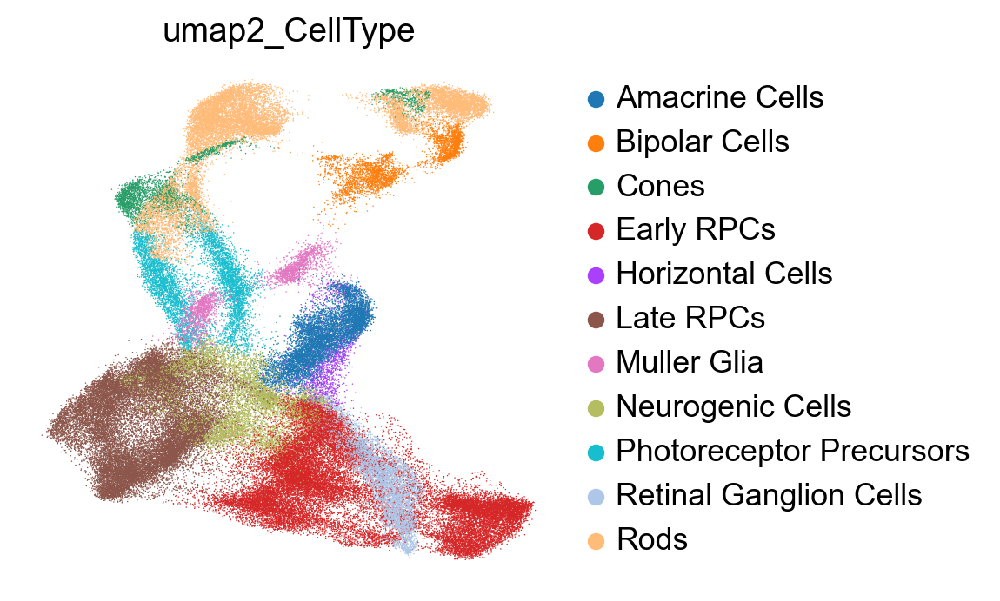

In [16]:
refdata.obsm['X_umap'] = refdata.obs[['umap_coord1', 'umap_coord2']].values
sc.pl.umap(refdata, 
           color='umap2_CellType',
           frameon=False)

In [17]:
refdata.shape

(107052, 27998)

クエリデータ（ここまで扱ってきたデータ）を **カウントデータ** として用意する。scANVIはscVIと同様、カウントデータを学習する確率モデルであるため。別レイヤーに取っておいたカウントのデータから新しいanndataを作る。

リファレンスデータは 'sample' のラベルのところに別々のタイムポイントからとったサンプルのラベルが記載されている。これをバッチと捉えてバッチ補正を行いたいので、クエリ側のバッチラベル（"E2", "F2"）もここに記述しておく。

In [18]:
from anndata import AnnData
query = AnnData(X=adata.layers['counts'], obs=adata.obs, var=adata.var)
query.obs['sample'] = query.obs['batch']

リファレンスとクエリのデータをひとつのanndataにまとめる。

In [19]:
refdata.var_names_make_unique()
alldata = refdata.concatenate(query)

In [20]:
alldata.obs

,Unnamed: 0,sample,age,Size_Factor,num_genes_expressed,Total_mRNAs,umap_cluster,umap_coord1,umap_coord2,umap_coord3,...,total_counts_mt,pct_counts_mt,n_counts,leiden_r0.5,_scvi_batch,_scvi_labels,leiden_scVI,SOLO_prediction,_scvi_raw_norm_scaling,Manual_annotation
E11.AAACCTGAGATGTAAC-1-0,E11.AAACCTGAGATGTAAC.1,E11,E11,1.733369,1549.0,2794.0,130.0,3.581455,-4.245770,-3.752502,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
E11.AAACCTGAGGCAATTA-1-0,E11.AAACCTGAGGCAATTA.1,E11,E11,2.201143,1848.0,3548.0,103.0,2.634151,-5.016846,-3.926956,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
E11.AAACCTGAGTAGCGGT-1-0,E11.AAACCTGAGTAGCGGT.1,E11,E11,2.381057,1935.0,3838.0,130.0,3.268848,-3.967177,-3.942664,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
E11.AAACCTGAGTGGAGTC-1-0,E11.AAACCTGAGTGGAGTC.1,E11,E11,2.861238,2139.0,4612.0,115.0,3.737625,-4.926516,-4.012058,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
E11.AAACCTGCAAGTTGTC-1-0,E11.AAACCTGCAAGTTGTC.1,E11,E11,2.044805,1723.0,3296.0,77.0,3.857854,-4.027292,-2.717437,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAAGGGCTCTC-1-F2-1,NaN,F2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,143.0,1.915606,7465.0,9,1.0,0.0,1,singlet,1.339585,RGC
TTTGTCACATCGATGT-1-F2-1,NaN,F2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,135.0,2.686033,5026.0,3,1.0,0.0,2,singlet,1.989654,Amacrine
TTTGTCAGTAGAGGAA-1-F2-1,NaN,F2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,176.0,2.660620,6615.0,0,1.0,0.0,4,doublet,1.511716,NaN
TTTGTCAGTCATCCCT-1-F2-1,NaN,F2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,121.0,2.457851,4923.0,5,1.0,0.0,9,singlet,2.031282,NaN


前半でやったのと同じような、シングルセル解析の前処理をデータ全体に対して実行する。

In [21]:
alldata.layers['counts'] = alldata.X.copy()
sc.pp.normalize_per_cell(alldata, counts_per_cell_after=1e4)
sc.pp.log1p(alldata)
alldata.raw = alldata

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added
    'n_counts', counts per cell before normalization (adata.obs)


In [22]:
sc.pp.highly_variable_genes(alldata, n_top_genes=2000, flavor='seurat')

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


scVIを利用してデータ全体のバッチ補正を行う統合モデルを学習する。CPUで学習する場合は時間かかる。一般的なPCのCPUオンリー計算で数時間から半日くらい。

In [23]:
scvi.model.SCVI.setup_anndata(alldata, layer='counts', batch_key='sample')

In [24]:
#integration_model = scvi.model.SCVI(alldata)
#integration_model.train()

In [25]:
#integration_model.save('./models/integration_model')

In [26]:
integration_model = scvi.model.SCVI.load('./models/integration_model', alldata)

INFO     File ./models/integration_model/model.pt already downloaded                                               


In [27]:
alldata.obsm['X_scVI'] = integration_model.get_latent_representation()

In [28]:
alldata.obs['DataFrom'] = np.where(alldata.obs['sample'].isin(['E2', 'F2']), 'Query', 'Ref')

In [29]:
sc.pp.neighbors(alldata,
                n_neighbors=30,
                use_rep="X_scVI")
sc.tl.umap(alldata, min_dist=0.5)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:20)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:01:00)


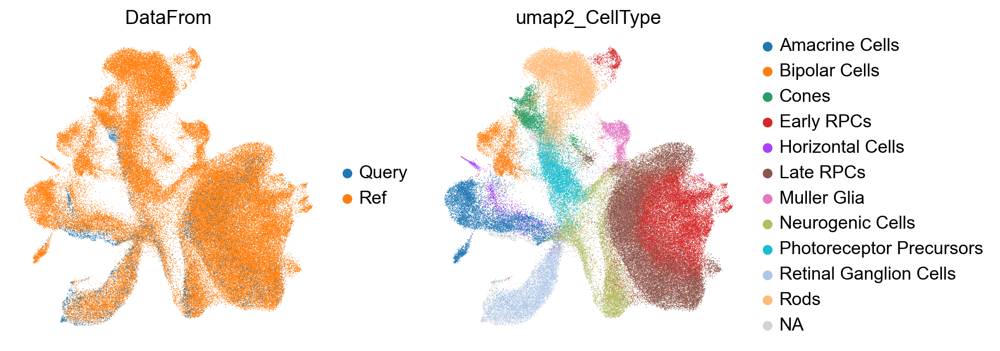

In [30]:
sc.pl.umap(alldata, 
           color=['DataFrom', 'umap2_CellType'],
           ncols=2,
           frameon=False)

リファレンス側のデータでcell typeが記述されているカラム（'umap2_CellType'）が、クエリ側のデータでは現在 NaN になっているので、ここを全部 'Unknown' にセットしておく。

In [31]:
alldata.obs['umap2_CellType'] = alldata.obs['umap2_CellType'].cat.add_categories('Unknown')
alldata.obs = alldata.obs.fillna({'umap2_CellType':'Unknown'})

統合モデル、統合データ、未知ラベルのカラムと名前を指定してscANVIモデルをセットアップする。

In [32]:
label_model = scvi.model.SCANVI.from_scvi_model(integration_model,
                                                adata=alldata,
                                                unlabeled_category='Unknown',
                                                labels_key='umap2_CellType')

ラベル転移の学習を実行する。ここはそれほど計算時間かからない（ようにパラメータを設定しているが精度はじゅうぶん出る）

In [33]:
#label_model.train(n_samples_per_label=100)
#label_model.save('./models/label_transfer')

In [34]:
label_model = scvi.model.SCANVI.load('./models/label_transfer/', alldata)

INFO     File ./models/label_transfer/model.pt already downloaded                                                  


学習されたモデルでcell typeの予測を実行する。

In [35]:
# predict関数で、soft=Trueとすれば、最大確率のラベルだけでなく、それぞれのラベルの確率値をちゃんと出してくれる
alldata.obs['predicted_celltype'] = label_model.predict(alldata)

この予測結果全体からクエリ側に対応するデータだけ抜き出して、以下のようにcsvとして保存したのが配布しているデータ。

In [36]:
predictions = alldata.obs[(alldata.obs['sample'] == 'E2') | (alldata.obs['sample'] == 'F2')]['predicted_celltype']
predictions.index = predictions.index.str[:-2]
predictions.to_csv('./models/label_transfer/celltype_predictions.csv')

### ***講習ではここから再開***

csvファイルをロード。

In [37]:
predictions = pd.read_csv('./models/label_transfer/celltype_predictions.csv', index_col=0)

In [38]:
predictions

,predicted_celltype
AAACCTGAGATGTCGG-1-E2,Muller Glia
AAACCTGCAATCCAAC-1-E2,Late RPCs
AAACCTGTCCAATGGT-1-E2,Horizontal Cells
AAACGGGAGGCAATTA-1-E2,Early RPCs
AAACGGGCACGGCGTT-1-E2,Early RPCs
...,...
TTTGTCAAGGGCTCTC-1-F2,Retinal Ganglion Cells
TTTGTCACATCGATGT-1-F2,Horizontal Cells
TTTGTCAGTAGAGGAA-1-F2,Neurogenic Cells
TTTGTCAGTCATCCCT-1-F2,Photoreceptor Precursors


adataに予測されたラベルを格納。

In [39]:
adata.obs['predicted_celltype'] = predictions.loc[adata.obs.index, 'predicted_celltype']

予測されたラベルの細胞数カウントは以下。それっぽいラベルが並んでいる。

In [40]:
adata.obs['predicted_celltype'].value_counts()

predicted_celltype
Retinal Ganglion Cells      1073
Late RPCs                    915
Early RPCs                   713
Neurogenic Cells             638
Amacrine Cells               444
Horizontal Cells             437
Photoreceptor Precursors     223
Cones                        206
Muller Glia                  114
Bipolar Cells                  6
Rods                           4
Name: count, dtype: int64

以下が予測結果で色分けしたUMAP。

RPCs は Retinal Progenitor Cells の略。

RPCs からNeurogenicにつながって、Photoreceptor/Conesに分岐していく流れと、Amacrine/Horizontalに分岐していく流れと、Retinal ganglion cellsに分岐する3つの流れに分かれていることがわかった。

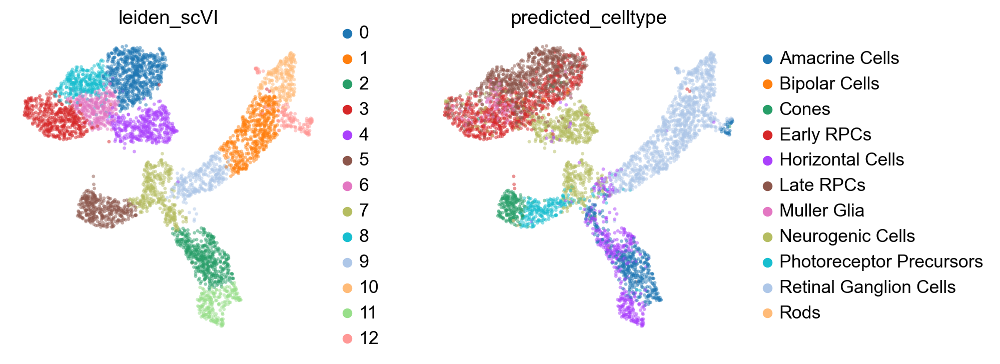

In [41]:
sc.pl.umap(adata,
    color=['leiden_scVI', 'predicted_celltype'],
    frameon=False, alpha=0.5,
    ncols=2)

Leidenクラスタに名前をつけたいので、それぞれのクラスタに所属している細胞がどのcell typeラベルを持っているのか、数をクロス集計してみる。

In [42]:
pd.crosstab(adata.obs['leiden_scVI'], adata.obs['predicted_celltype'])

predicted_celltype,Amacrine Cells,Bipolar Cells,Cones,Early RPCs,Horizontal Cells,Late RPCs,Muller Glia,Neurogenic Cells,Photoreceptor Precursors,Retinal Ganglion Cells,Rods
leiden_scVI,,,,,,,,,,,
0,0,3,6,193,2,457,3,2,0,0,0
1,0,0,0,0,1,0,0,0,0,538,0
2,282,0,0,0,184,1,0,3,0,1,0
3,0,0,1,309,0,73,46,26,0,0,2
4,0,0,0,7,10,14,0,370,0,0,0
5,0,0,198,3,2,0,0,0,152,0,2
6,0,3,0,177,0,102,44,10,0,0,0
7,49,0,0,0,37,0,0,192,58,0,0
8,0,0,0,24,0,268,21,12,0,0,0


このカウントを元に、多数決で以下のような適当な名前をつけた。

In [43]:
leiden_to_celltypes = {
    '0':'Late-RPCs-1',
    '1':'RGCs-1',
    '2':'Amacrine',
    '3':'Early-RPCs-1',
    '4':'Neurogenic-1',
    '5':'Cones',
    '6':'Early-RPCs-2',
    '7':'Neurogenic-2',
    '8':'Late-RPCs-2',
    '9':'RGCs-2',
    '10':'RGCs-3',
    '11':'Horizontal',
    '12':'RGCs-4'}

adata.obs['leiden_celltypes'] = [leiden_to_celltypes[v] for v in adata.obs['leiden_scVI'].values]

名前がついたLeidenクラスタを可視化してみる。

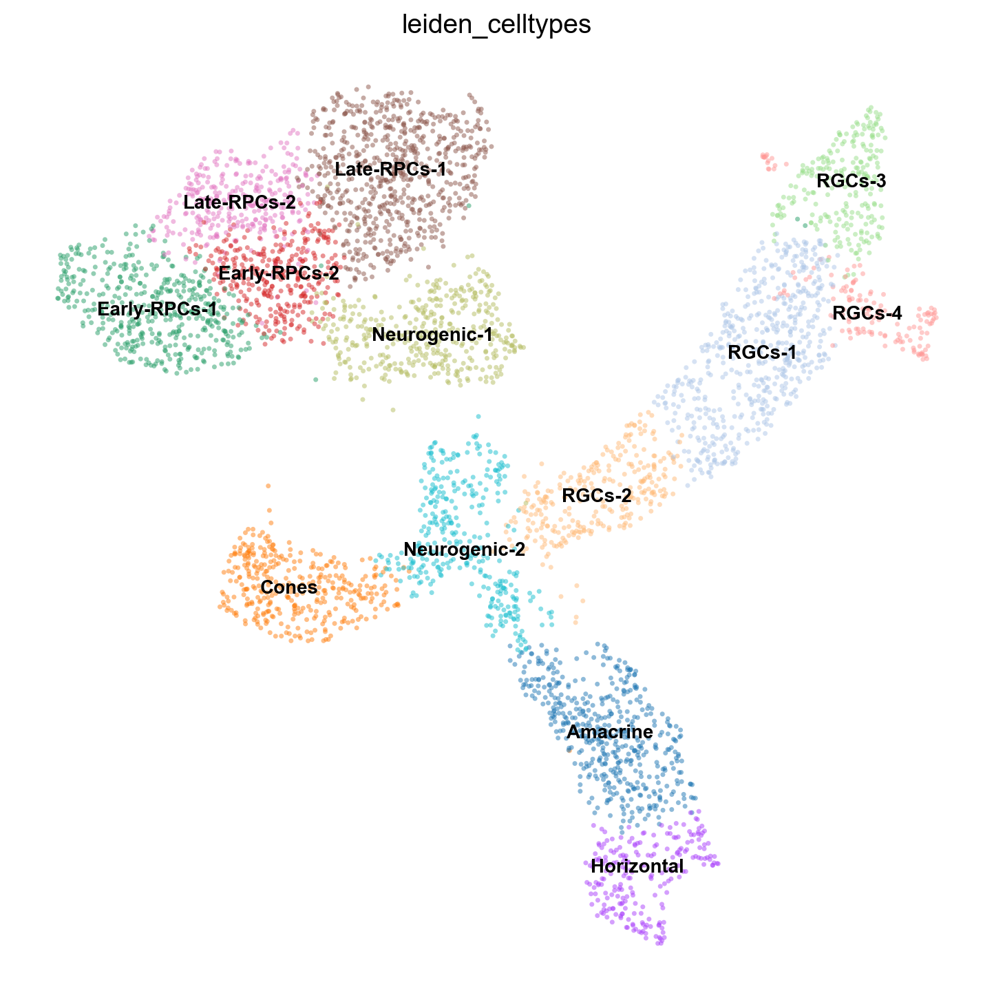

In [44]:
with plt.rc_context({"figure.figsize": (9, 9)}):
    sc.pl.umap(adata,
        color='leiden_celltypes',
        legend_fontsize=10,
        frameon=False, alpha=0.5,
        legend_loc='on data')

In [45]:
adata.write(filename='./data/retinal_2.h5ad')

## RNA速度の推定

### 事前準備（velocyto）

scVeloを使うためには、spliced/unsplicedの二種類のカウントデータが必要となる。

なので事前に [velocyto](http://velocyto.org/velocyto.py/index.html) を使って、Cell Rangerが生成したゲノムマッピングのBAMファイルから、spliced/unsplicedのカウントデータを作っておく。

バッチごとに実行して、それぞれのバッチに属する細胞のspliced/unsplicedカウントを格納した [loom](https://linnarssonlab.org/loompy/index.html) データを作る。

計算に時間がかかるので、講習ではすでにvelocyto計算済みの結果を配布している。

velocytoは以下のコマンドで実行する。

```bash
velocyto run10x \
    -m /path/to/Cell_Ranger_References/mm10_rmsk.gtf \
    /path/to/RetinalBatchE2 \
    /path/to/Cell_Ranger_References/refdata-gex-mm10-2020-A/genes/genes.gtf

velocyto run10x \
    -m /path/to/Cell_Ranger_References/mm10_rmsk.gtf \
    /path/to/RetinalBatchF2 \
    /path/to/Cell_Ranger_References/refdata-gex-mm10-2020-A/genes/genes.gtf
```

velocytoでバッチごとに推定したloomファイルを統合して書き出す。ここの統合処理も時間かかるので、統合後のデータを配布。

In [46]:
#import loompy
#loompy.combine(['./data/RetinalBatchE2.loom',
#                './data/RetinalBatchF2.loom'],
#               output_file='./data/retinal_velo.loom')

In [47]:
import scvelo as scv
scv.set_figure_params()

spliced/unsplicedのカウントデータを遺伝子発現テーブルと統合する。細胞のバーコードで紐づける。

In [48]:
ldata = sc.read_loom('./data/retinal_velo.loom')
adata = scv.utils.merge(adata, ldata)

In [ ]:
# ↑の読み込みでエラーが出るなら、loompyの先月のアップデートで修正されたバグに引っかかってる可能性が高い
# その場合は以下のコマンドで最新版を入れる
!pip uninstall -y loompy
!pip install pygpcca
!pip install --force-reinstall git+https://github.com/linnarsson-lab/loompy.git@3.0.8

***インストールを実行した場合ここで一度、カーネルの再起動を実行する***

上のメニューから Kernel → Restart Kernel

In [ ]:
import scanpy as sc
import scvelo as scv
scv.set_figure_params()
adata = sc.read_h5ad('./data/retinal_2.h5ad')

ldata = sc.read_loom('./data/retinal_velo.loom')
adata = scv.utils.merge(adata, ldata)

scVeloの関数で、遺伝子ごとのspliced/unsplicedカウントの比率を表示できる。実験プラットフォームにもよるが、だいたいunsplicedが25%程度らしい。クラスタごとにも表示。極端にunsplicedがとれてないクラスタがあるかどうかチェックする。

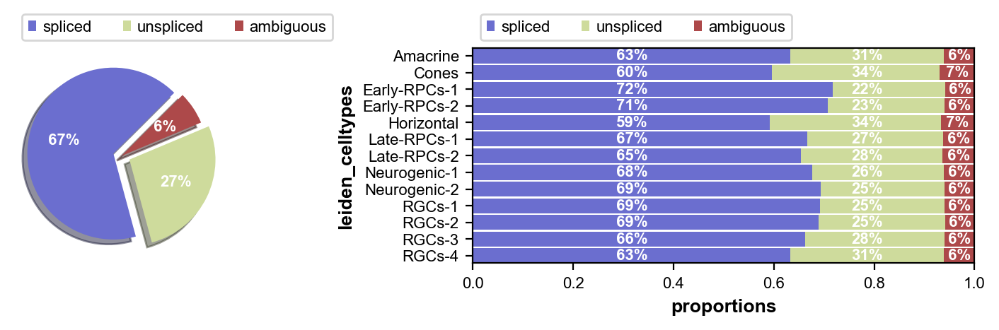

In [49]:
scv.pl.proportions(adata, groupby='leiden_celltypes')

速度計算を実行する。近傍グラフの構成から。

In [50]:
# scVI補完の潜在空間上で近傍グラフ構成、一次・二次モーメント計算
scv.pp.moments(adata, use_rep='X_scVI')

Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:05) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


Splicing kineticsモデルのパラメータ推論。

"Steady-state"モデル。

In [51]:
scv.tl.velocity(adata, mode='deterministic')

computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


速度ベクトルを元に、細胞から細胞への遷移確率を計算。

In [52]:
scv.tl.velocity_graph(adata)

computing velocity graph (using 1/8 cores)


  0%|          | 0/4773 [00:00<?, ?cells/s]

    finished (0:00:05) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


速度ベクトルから構成した「流れ」をプロットしてみる。

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


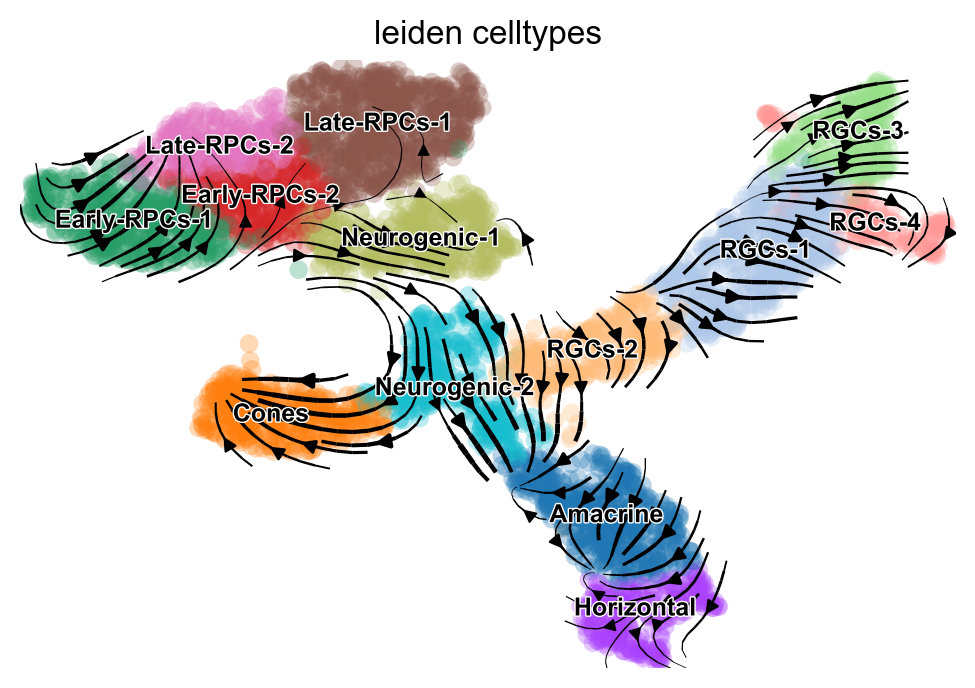

In [53]:
scv.pl.velocity_embedding_stream(adata, 
        basis='X_umap', color='leiden_celltypes',
        legend_fontsize=9,
        smooth=0.8, min_mass=4)

Progenitorの集団からはじまって、わかりやすい三分岐。

"EM"モデル。

In [54]:
scv.tl.recover_dynamics(adata, n_jobs=8)
scv.tl.recover_latent_time(
    adata,
    root_key='initial_states_probs', 
    end_key='terminal_states_probs')

recovering dynamics (using 8/8 cores)


  0%|          | 0/973 [00:00<?, ?gene/s]

    finished (0:01:28) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing terminal states
    identified 1 region of root cells and 2 regions of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:01) --> added 
    'latent_time', shared time (adata.obs)


「膨らみ方」（splicing kinetics）は遺伝子ごとに異なる。scVeloのscatter関数では遺伝子ごとに、具体的にどのようなダイナミクスが推定されたのかプロットしてくれる。それぞれの遺伝子がそれぞれ異なるタイミング、異なるパターンで、induction => steady-state => repressionのパスを巡っている。

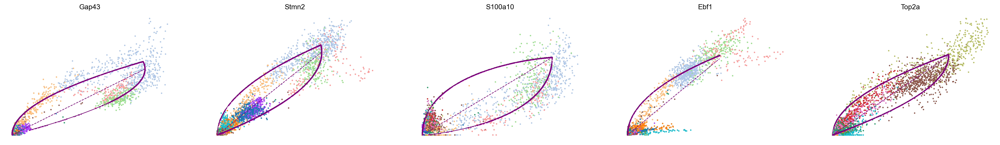

In [55]:
top_genes = adata.var["fit_likelihood"].sort_values(ascending=False).index
scv.pl.scatter(adata, basis=top_genes[:5], color="leiden_celltypes", frameon=False)

In [56]:
scv.tl.velocity(adata, mode="dynamical")
scv.tl.velocity_graph(adata, n_jobs=8)

computing velocities
    finished (0:00:04) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 8/8 cores)


  0%|          | 0/4773 [00:00<?, ?cells/s]

    finished (0:00:05) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


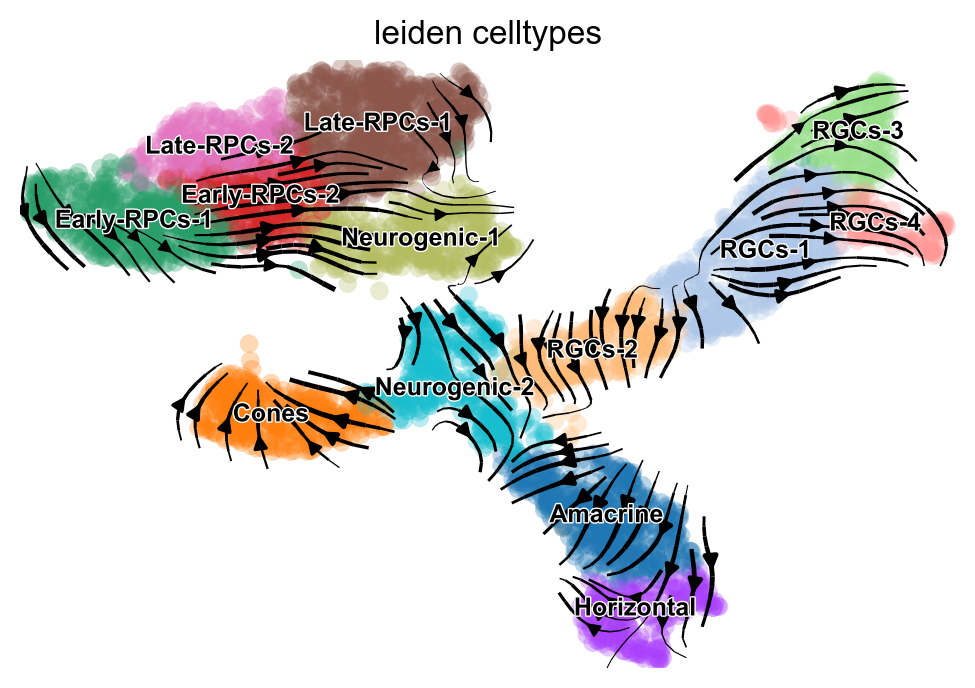

In [57]:
scv.pl.velocity_embedding_stream(adata, 
        basis='X_umap', color='leiden_celltypes',
        legend_fontsize=9,
        smooth=0.8, min_mass=4)

RNA速度を計算することによって、トランスクリプトームパターンの幾何学的な近接性だけで推定された 'Pseudo time' ではなく、速度情報をちゃんと織り込んだ細胞の 'Latent time' を計算できる。

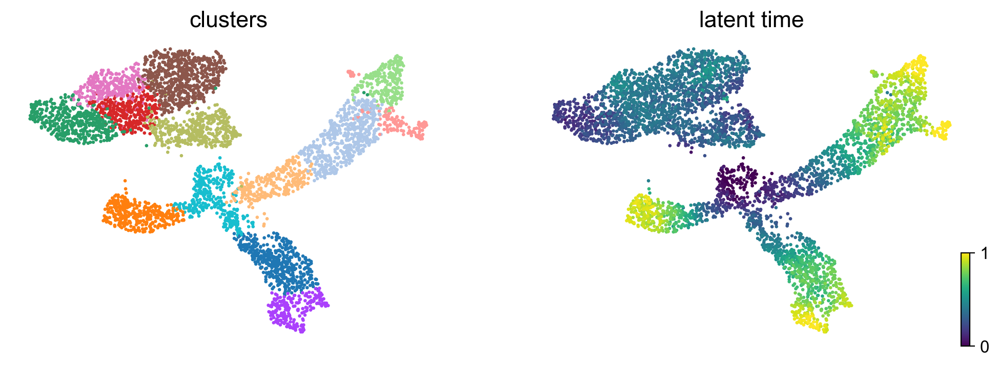

In [58]:
scv.pl.scatter(
    adata,
    color=['leiden_celltypes', 'latent_time'],
    fontsize=16,
    cmap='viridis',
    perc=[2, 98],
    colorbar=True,
    rescale_color=[0, 1],
    title=['clusters', 'latent time'])

Progenitorの部分がごちゃごちゃしてわかりにくいので、取り出して個別に解析してみる。

どうもグルグルとまわってるみたいなので、細胞周期のマーカー遺伝子発現をチェック。

In [59]:
prog = adata[adata.obs['leiden_celltypes'].isin(['Early-RPCs-1', 'Early-RPCs-2', 'Late-RPCs-1', 'Late-RPCs-2'])].copy()

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:00)


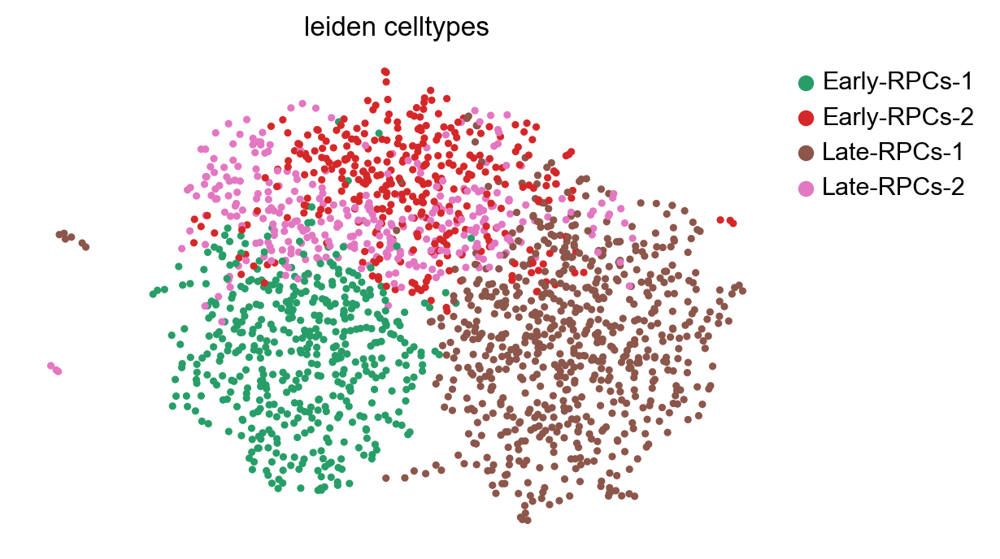

In [60]:
sc.pp.neighbors(prog, use_rep="X_scVI", n_neighbors=3)
sc.tl.umap(prog, min_dist=1.0)

scv.pl.umap(prog,
            color=['leiden_celltypes'],
            frameon=False)

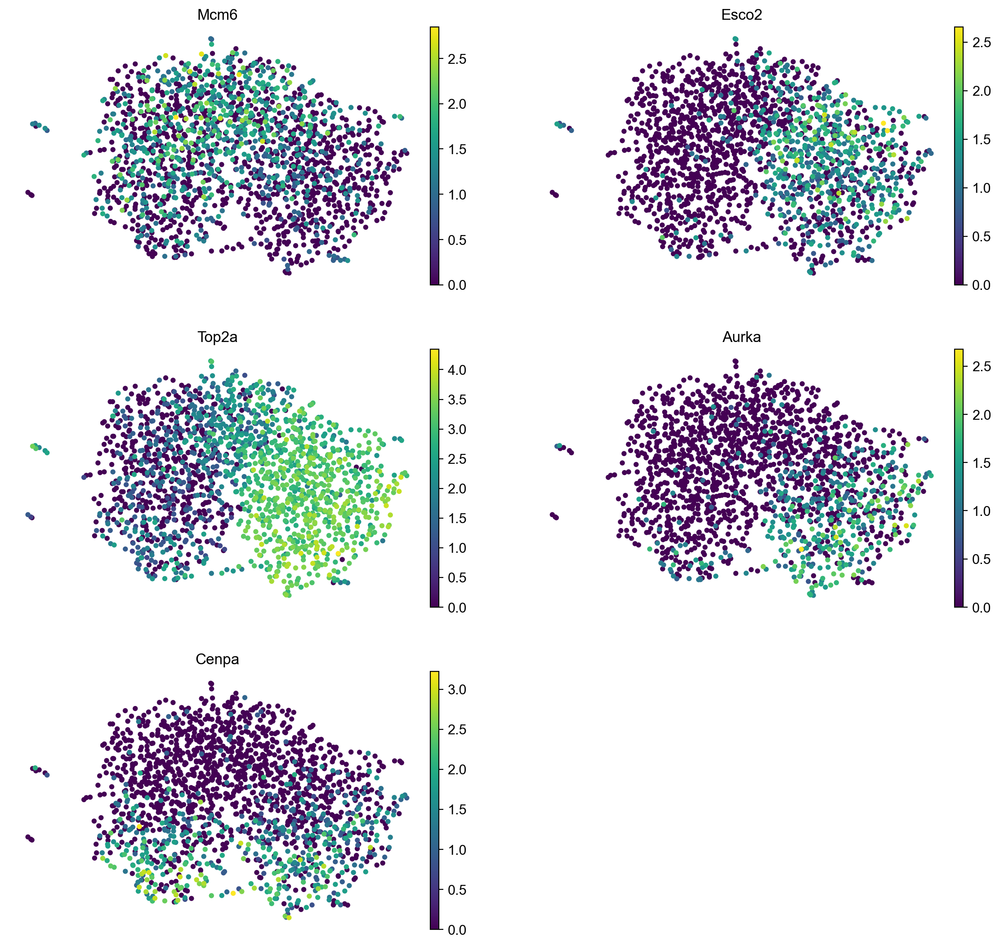

In [61]:
sc.pl.umap(prog, 
           ncols=2,
           color=['Mcm6', 'Esco2', 'Top2a', 'Aurka', 'Cenpa'],
           cmap='viridis',
           frameon=False)

というわけで、このグルグルは細胞周期を反映しているのだった。

この中だけで速度を描くとよりわかりやすい。

computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 8/8 cores)


  0%|          | 0/750 [00:00<?, ?gene/s]

    finished (0:00:19) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)


  0%|          | 0/1784 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


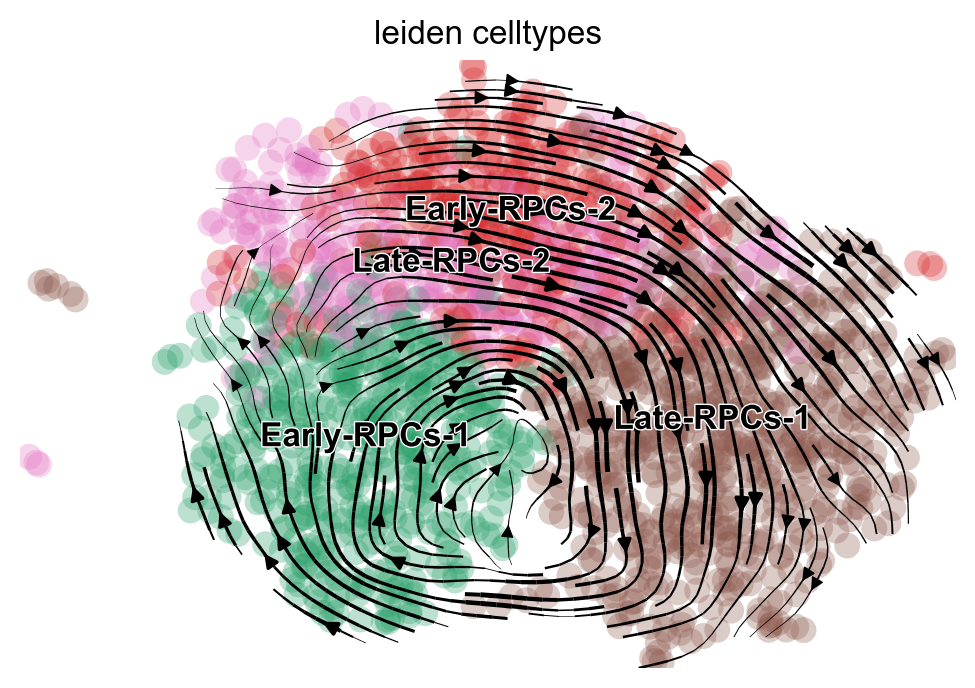

In [62]:
scv.pp.moments(prog, use_rep='X_scVI')
scv.tl.recover_dynamics(prog, n_jobs=8)
scv.tl.velocity(prog, mode="dynamical")
scv.tl.velocity_graph(prog)
scv.pl.velocity_embedding_stream(prog, 
    basis='X_umap', color='leiden_celltypes',
    smooth=0.8, min_mass=4)

細かく見ると印象が違ってくることもあるので、流れの全体像として粗視化されたパターンだけでなく、それぞれの速度をつぶさに見ていくことも大事。

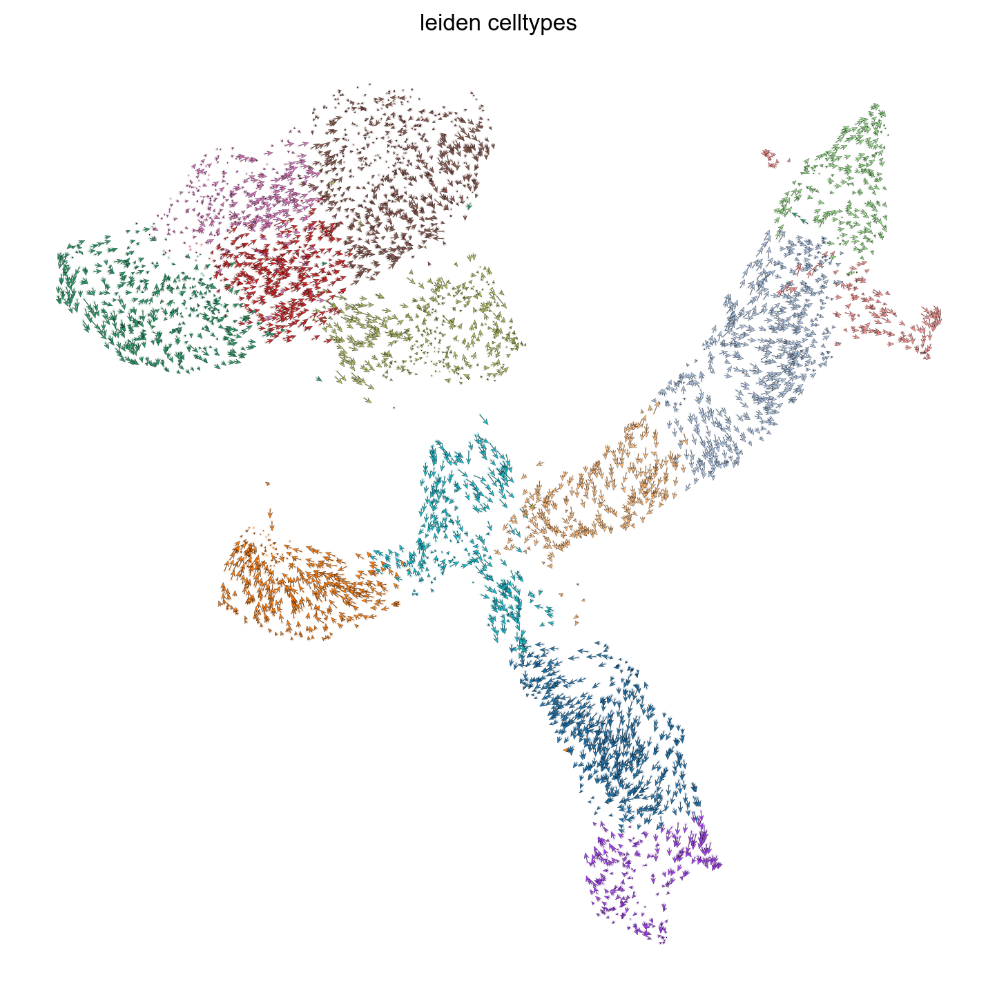

In [63]:
scv.pl.velocity_embedding(adata, figsize=(9, 9),
        basis='X_umap', color='leiden_celltypes',
        scale=0.5)

## CellRankによる「軌道」上の遺伝子発現ダイナミクス

単に幾何学的な軌道（高次元空間における枝上の構造）を特定して情報を圧縮するのではなく、RNA速度情報を利用してそれぞれの細胞ごとに「細胞運命」を確率的に推定するフレームワーク。

CellRank:
    Lange, M., Bergen, V., Klein, M. et al. CellRank for directed single-cell fate mapping. Nat Methods 19, 159–170 (2022). https://doi.org/10.1038/s41592-021-01346-6

CellRank2:
    Weiler, P., Lange, M., Klein, M. et al. CellRank 2: unified fate mapping in multiview single-cell data. Nat Methods 21, 1196–1205 (2024). https://doi.org/10.1038/s41592-024-02303-9


最新版リリースのCellRankでは、内部的に呼び出しているPyGAMの仕様により、Scipy<1.14にバージョンを落とさないと使えない。
CellRankのためだけにScipyのバージョン落としたくないので、かなり強引な解決方法だがここではScipyのプロパティ自体を書き換えるモンキーパッチ（実行時に既存のクラスや関数の振る舞いを変更する手法）をあてる。非推奨。現実的には、CellRankがScipyの特定バージョンに依存している以上、CellRankだけ切り出して隔離したPython環境を作った方がいい。

In [64]:
# 講習のため。非推奨。
import scipy.sparse
def to_array(self):
    return self.toarray()
scipy.sparse.spmatrix.A = property(to_array)
import pygam

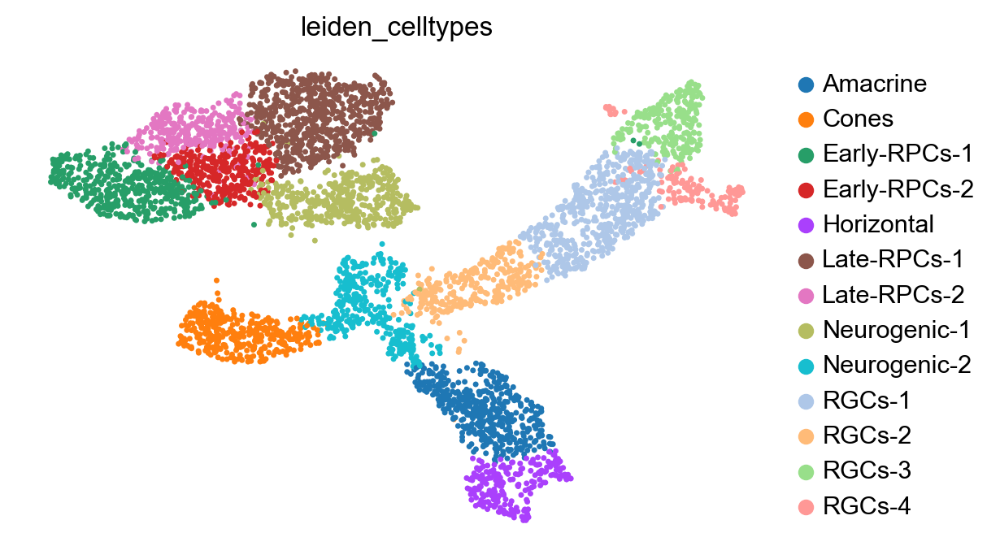

In [65]:
sc.pl.umap(adata, color=['leiden_celltypes'], frameon=False)

In [66]:
import cellrank as cr
cr.settings.verbosity = 2

確率推論の前提となる細胞間の空間的・時間的前後関係を持つ情報（カーネル）を設定。

カーネルはいくつかの選択肢がある。RNA速度のほか、幾何学的に推定したPseudotime、実験的に測定した「実時間」でもオーケー。それぞれに対応したカーネルが用意されているので、適切なものを選択する。

In [67]:
from cellrank.kernels import VelocityKernel

# scVeloで推定した「時間」が latent_time のカラム名で保存されているので、それを指定する
vk = VelocityKernel(adata, time_key='latent_time')

細胞間の遷移行列を推定。

In [68]:
vk.compute_transition_matrix()

Computing transition matrix using `'deterministic'` model


  0%|          | 0/4773 [00:00<?, ?cell/s]

Using `softmax_scale=3.0619`


  0%|          | 0/4773 [00:00<?, ?cell/s]

    Finish (0:00:05)


VelocityKernel[n=4773, model='deterministic', similarity='correlation', softmax_scale=np.float64(3.062)]

ひとつひとつの細胞ごとの遷移だと解釈が難しい。そこで、GPCCA（Generalized Perron Cluster Cluster Analysis ）という手法で、遷移行列から「マクロ状態」（初期集団、中間集団、終了集団）のパターンに集約する。

In [69]:
from cellrank.estimators import GPCCA

g = GPCCA(vk)
print(g)

GPCCA[kernel=VelocityKernel[n=4773], initial_states=None, terminal_states=None]


Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[np.int64(2)]`
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
Computing `6` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)


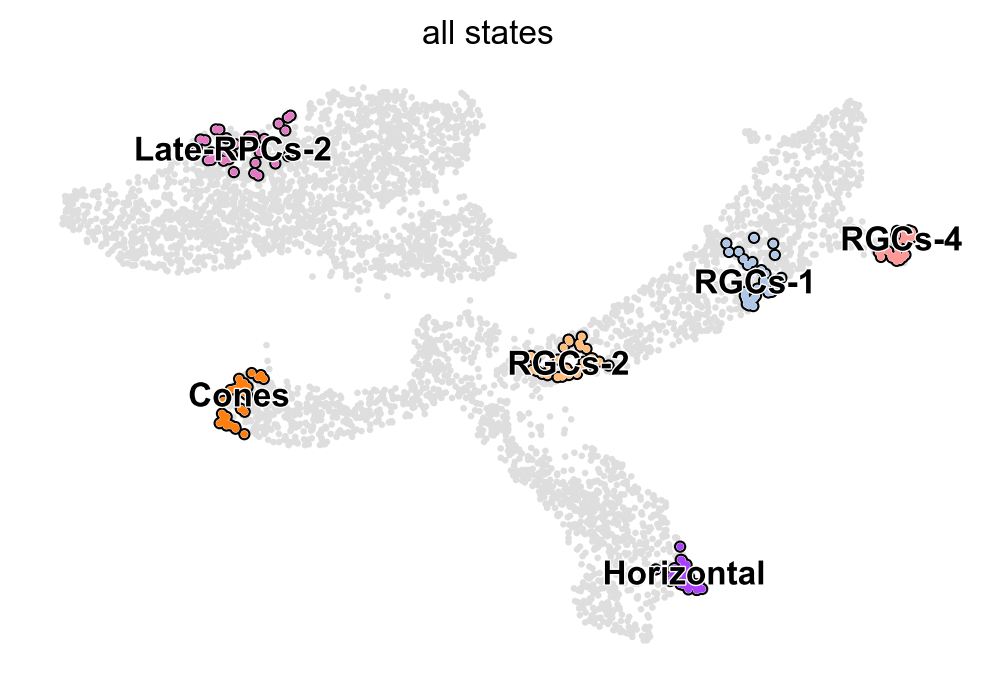

In [70]:
g.fit(n_states=6, cluster_key="leiden_celltypes")
g.plot_macrostates(which="all")

「終了状態」の推定。

Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


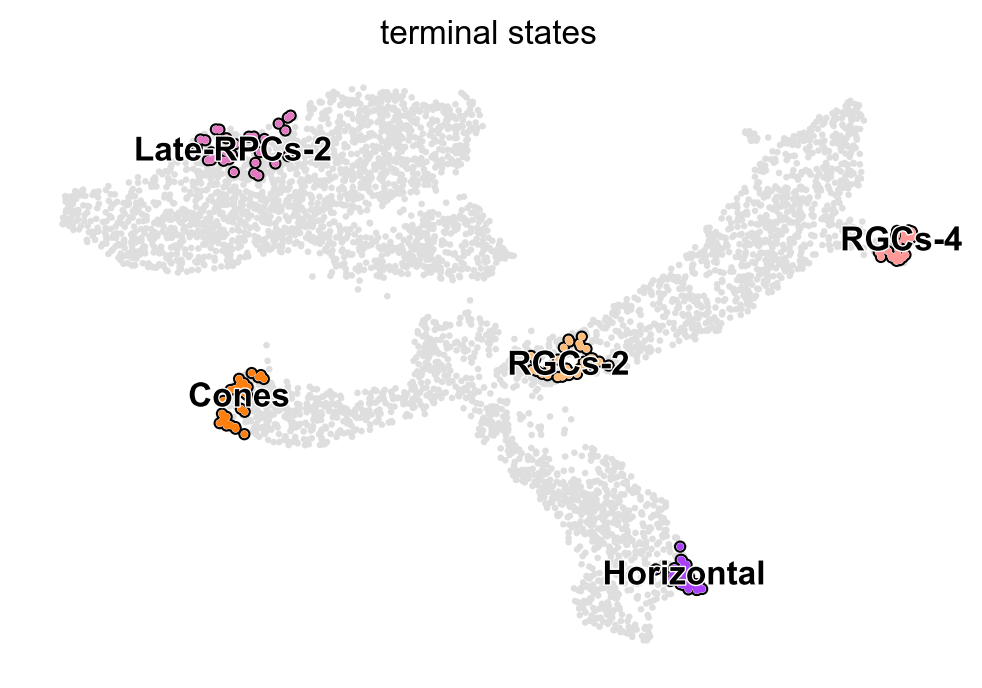

In [71]:
g.predict_terminal_states(method="top_n", n_states=5, allow_overlap=True)
g.plot_macrostates(which="terminal")

「運命確率」の計算。色の濃い細胞が、対応する「終了状態」に到達しやすい。

Computing fate probabilities


  0%|          | 0/5 [00:00<?, ?/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)


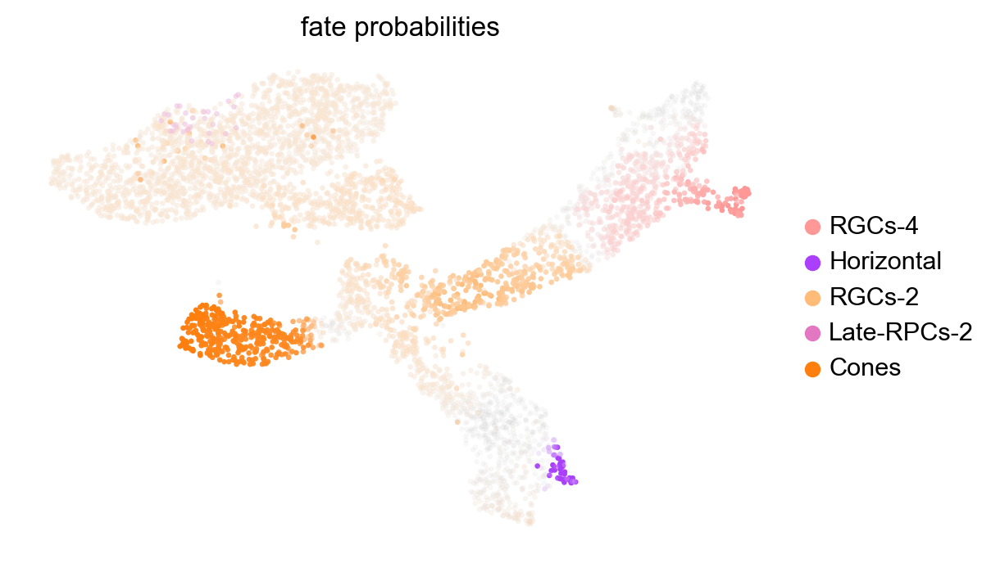

In [72]:
g.compute_fate_probabilities()
g.plot_fate_probabilities(legend_loc="right")

教科書的には、次のような転写因子などが3方向の分化に強く影響すると言われている。これらの遺伝子検出をCellRankで再現できるか試してみる。

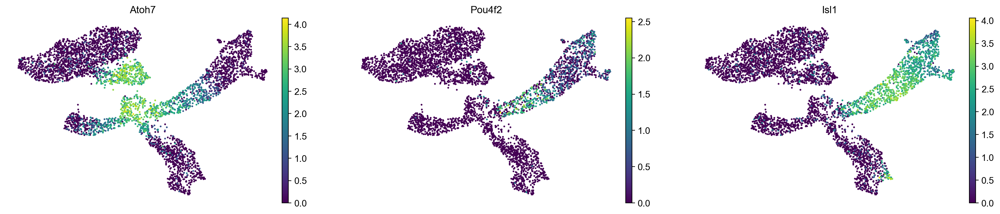

In [73]:
# RGCへの分化
sc.pl.umap(adata,
           ncols=3,
           color=['Atoh7', 'Pou4f2', 'Isl1'],
           cmap='viridis', s=18,
           frameon=False)

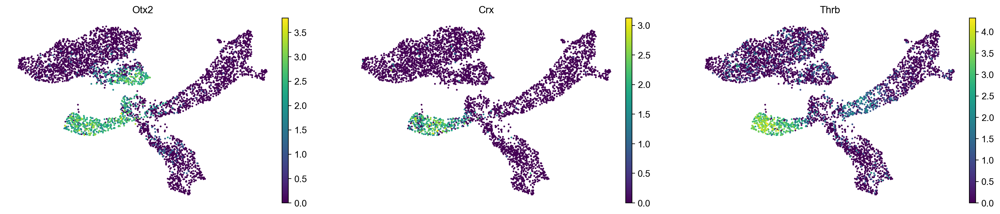

In [74]:
# 錐体細胞への分化
sc.pl.umap(adata,
           ncols=3,
           color=['Otx2', 'Crx', 'Thrb'],
           cmap='viridis', s=18,
           frameon=False)

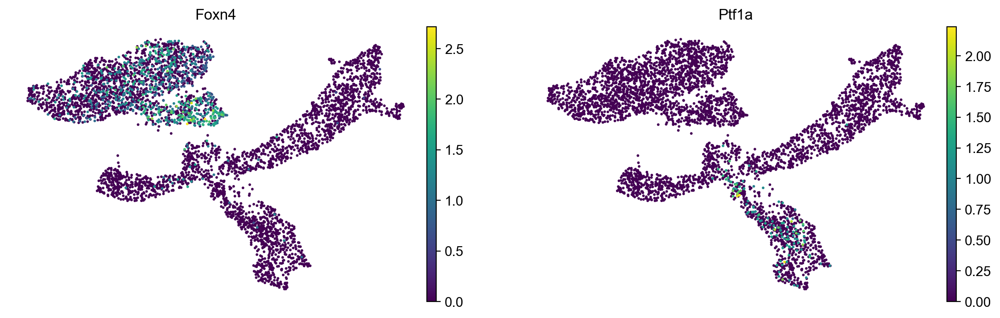

In [75]:
# アマクリン細胞・水平細胞への分化
sc.pl.umap(adata,
           ncols=3,
           color=['Foxn4', 'Ptf1a'],
           cmap='viridis', s=18,
           frameon=False)

### RGCへの分化

経路と遺伝子発現の「相関」の計算について、特定のクラスタ（三分岐した他の経路など）の細胞が邪魔になる場合は、clustersオプションで計算に使うクラスタを限定できる。（初期状態から終了状態の経路上のクラスタのみ使う、など）

In [76]:
RGC_df = g.compute_lineage_drivers(
    lineages=['RGCs-4'],
    cluster_key='leiden_celltypes',
)
RGC_df = RGC_df.sort_values(by=['RGCs-4_corr'], ascending=False)
RGC_df.head(10)

Adding `adata.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:00)


,RGCs-4_corr,RGCs-4_pval,RGCs-4_qval,RGCs-4_ci_low,RGCs-4_ci_high
Sncg,0.877489,0.0,0.0,0.870796,0.883856
Pou6f2,0.863910,0.0,0.0,0.856533,0.870935
Gap43,0.806407,0.0,0.0,0.796253,0.816107
Mapt,0.805311,0.0,0.0,0.795106,0.815060
Syt4,0.789335,0.0,0.0,0.778396,0.799795
Rgs6,0.788204,0.0,0.0,0.777213,0.798714
S100a10,0.783338,0.0,0.0,0.772127,0.794061
Ina,0.772867,0.0,0.0,0.761186,0.784046
Ebf1,0.771255,0.0,0.0,0.759502,0.782503
Gng3,0.760803,0.0,0.0,0.748590,0.772500


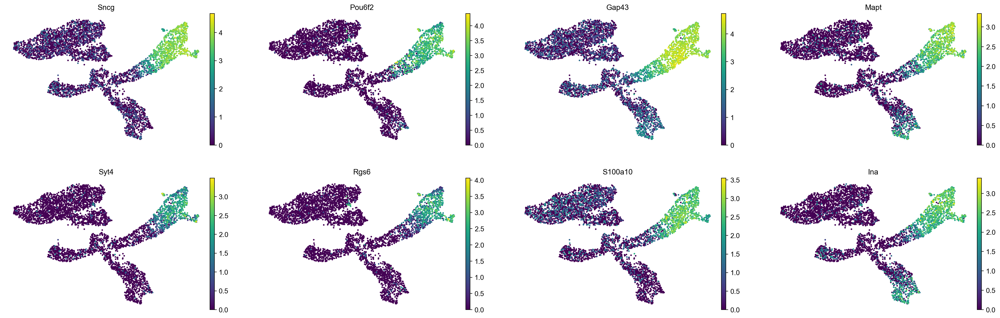

In [77]:
driver_genes = RGC_df.index[:8]

sc.pl.umap(
    adata,
    color=driver_genes,
    cmap='viridis', ncols=4,
    frameon=False)

経路上の遺伝子発現ダイナミクスのモデル化。ここでは一般化加法モデル（Generalized Additive Models）を利用。

In [78]:
gam_model = cr.models.GAM(adata, n_knots=6)

ダイナミクスの計算に使う発現量の数値、時間の数値、それぞれに対応するカラム名をちゃんと指定する（ここではそれぞれ、scvi_normalized, latent_time）

Computing trends using `1` core(s)


  0%|          | 0/60 [00:00<?, ?gene/s]

    Finish (0:00:01)


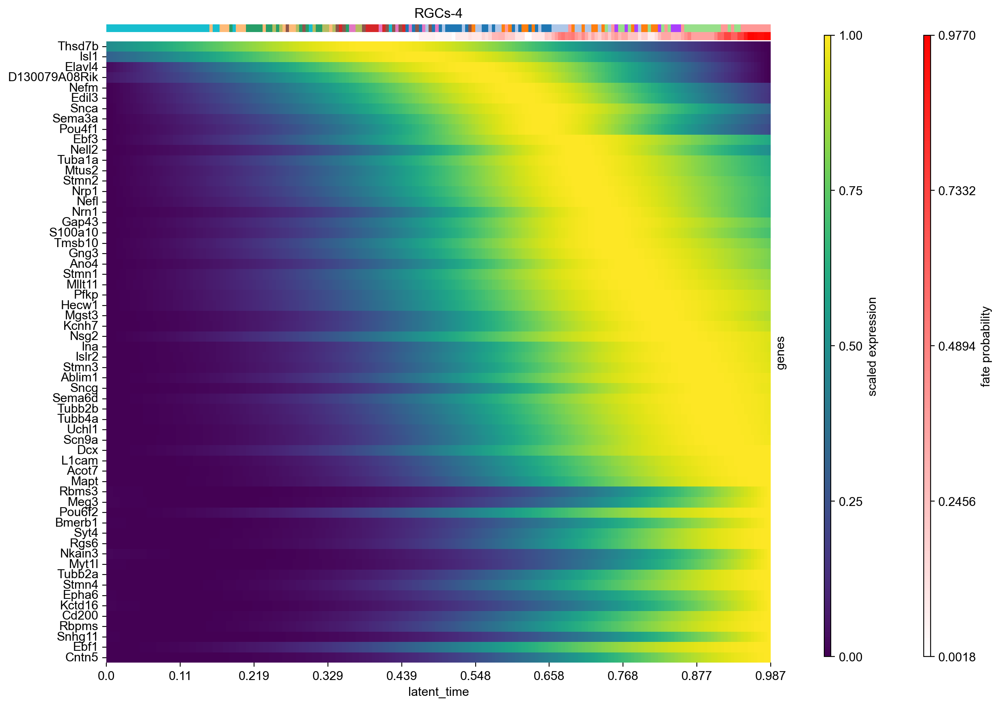

In [79]:
cr.pl.heatmap(
    adata,
    model=gam_model,
    lineages='RGCs-4',
    cluster_key='leiden_celltypes',
    show_fate_probabilities=True,
    data_key='scvi_normalized',
    genes=RGC_df.head(60).index,
    time_key='latent_time',
    figsize=(12, 10),
    show_all_genes=True,
    weight_threshold=(1e-3, 1e-3),
)

### アマクリン細胞・水平細胞への分化

Adding `adata.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:00)


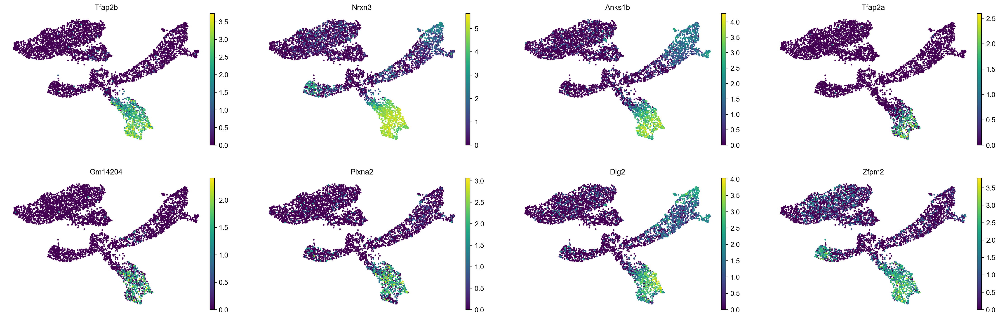

In [80]:
HR_df = g.compute_lineage_drivers(
    lineages=['Horizontal'],
    cluster_key='leiden_celltypes'
)
HR_df = HR_df.sort_values(by=['Horizontal_corr'], ascending=False)

driver_genes = HR_df.index[:8]
sc.pl.umap(
    adata,
    color=driver_genes,
    cmap='viridis', ncols=4,
    frameon=False)

Computing trends using `1` core(s)


  0%|          | 0/60 [00:00<?, ?gene/s]

    Finish (0:00:01)


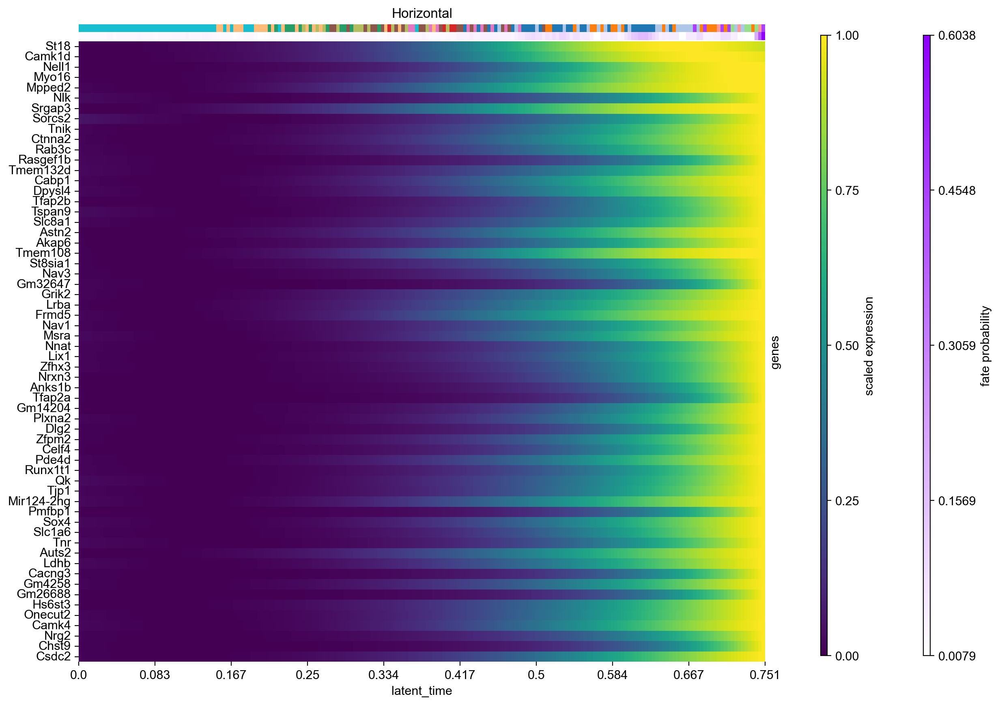

In [81]:
cr.pl.heatmap(
    adata,
    model=gam_model,
    lineages='Horizontal',
    cluster_key='leiden_celltypes',
    show_fate_probabilities=True,
    data_key='scvi_normalized',
    genes=HR_df.head(60).index,
    time_key='latent_time',
    figsize=(12, 10),
    show_all_genes=True,
    weight_threshold=(1e-3, 1e-3),
)

### 錐体細胞への分化

Adding `adata.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:00)


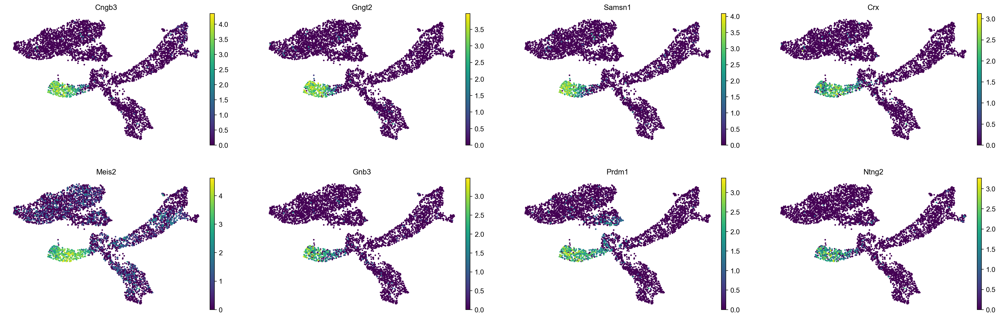

In [82]:
CP_df = g.compute_lineage_drivers(
    lineages=['Cones'],
    cluster_key='leiden_celltypes'
)
CP_df = CP_df.sort_values(by=['Cones_corr'], ascending=False)

driver_genes = CP_df.index[:8]
sc.pl.umap(
    adata,
    color=driver_genes,
    cmap='viridis', ncols=4,
    frameon=False)

Computing trends using `1` core(s)


  0%|          | 0/60 [00:00<?, ?gene/s]

    Finish (0:00:01)


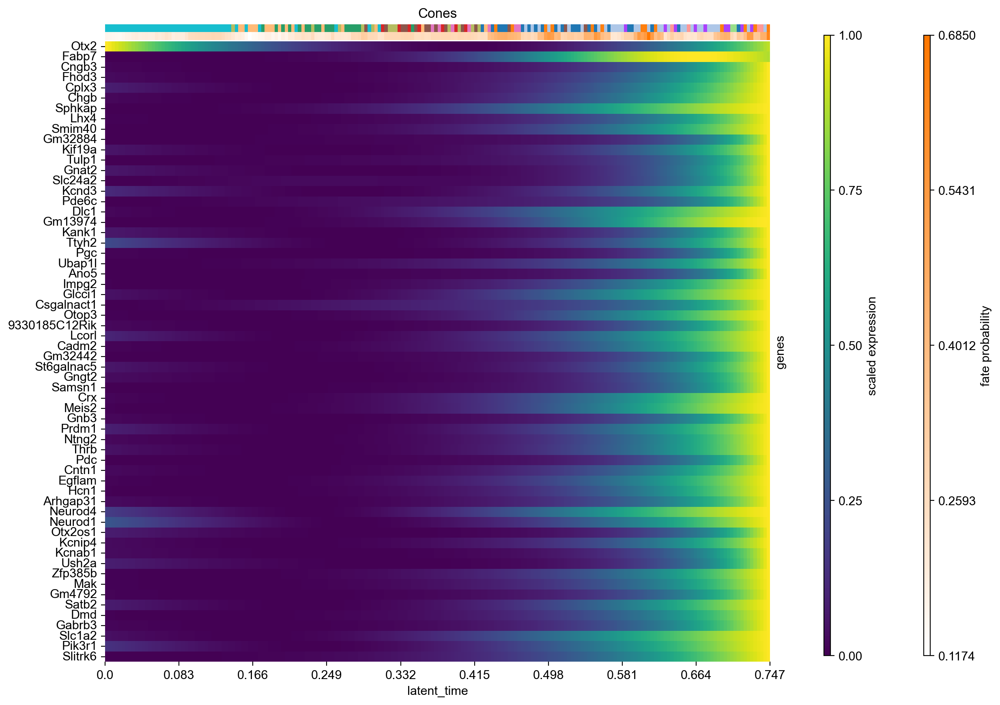

In [83]:
cr.pl.heatmap(
    adata,
    model=gam_model,
    lineages='Cones',
    cluster_key='leiden_celltypes',
    show_fate_probabilities=True,
    data_key='scvi_normalized',
    genes=CP_df.head(60).index,
    time_key='latent_time',
    figsize=(12, 10),
    show_all_genes=True,
    weight_threshold=(1e-3, 1e-3),
)

###　経路ごとの遺伝子発現ダイナミクス

Computing trends using `1` core(s)


  0%|          | 0/8 [00:00<?, ?gene/s]

    Finish (0:00:00)
Plotting trends


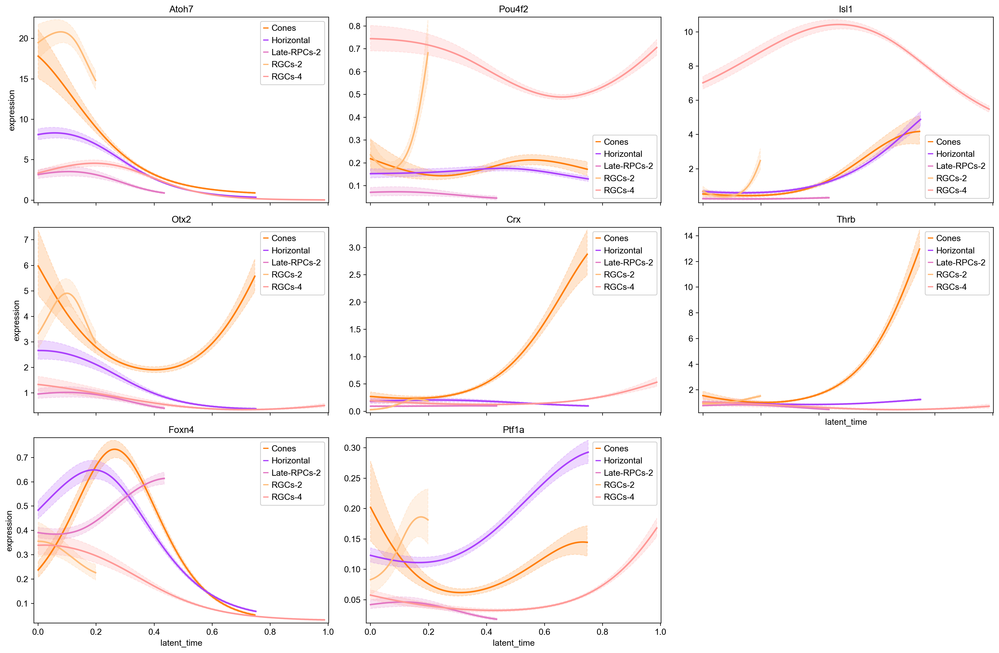

In [84]:
cr.pl.gene_trends(
    adata,
    model=gam_model,
    data_key='scvi_normalized',
    genes=['Atoh7', 'Pou4f2', 'Isl1',
           'Otx2', 'Crx', 'Thrb',
           'Foxn4', 'Ptf1a'],
    same_plot=True,
    ncols=3,
    time_key='latent_time',
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)

In [85]:
adata.write(filename='./data/retinal_3.h5ad')